<a href="https://colab.research.google.com/github/theanhvu1998/VuTheAnh_Assignment/blob/master/Vu_The_Anh_Assignment_4_.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Team 6 - World Cup

![](https://img.fifa.com/image/upload/t_l4/v1543921822/ex1ksdevyxwsgu7rzdv6.jpg)

_For more information about the dataset, read [here](https://www.kaggle.com/abecklas/fifa-world-cup)._

## Your tasks
- Name your team!
- Read the source and do some quick research to understand more about the dataset and its topic
- Clean the data
- Perform Exploratory Data Analysis on the dataset
- Analyze the data more deeply and extract insights
- Visualize your analysis on Google Data Studio
- Present your works in front of the class and guests next Monday

## Submission Guide
- Create a Github repository for your project
- Upload the dataset (.csv file) and the Jupyter Notebook to your Github repository. In the Jupyter Notebook, **include the link to your Google Data Studio report**.
- Submit your works through this [Google Form](https://forms.gle/oxtXpGfS8JapVj3V8).

## Tips for Data Cleaning, Manipulation & Visualization
- Here are some of our tips for Data Cleaning, Manipulation & Visualization. [Click here](https://hackmd.io/cBNV7E6TT2WMliQC-GTw1A)

_____________________________

## Some Hints for This Dataset:
- Is there a way to integrate the data from all 3 datasets?
- It seems like the `winners` dataset doesn't have data of World Cup 2018. Can you Google the relevant information and add it to the dataset using `pandas`?
- The format of some number columns in `matches` dataset doesn't look right.
- Can you seperate the Date and the Time of `Datetime` column in `matches` dataset?
- And more...

# Assignment_4_Vu_The_Anh

## link google report
[here](https://datastudio.google.com/reporting/33614c0b-4c76-45a0-812b-744aed680971)

## install pandas_profiling

In [1]:
!pip install -U pandas_profiling

Requirement already up-to-date: pandas_profiling in /usr/local/lib/python3.6/dist-packages (2.8.0)


## import labrari
- pandas
- seaborn

In [2]:
import pandas as pd
import matplotlib.pyplot as plt
import pandas_profiling as pp
import seaborn as sns

/usr/local/lib/python3.6/dist-packages/statsmodels/tools/_testing.py:19: FutureWarning: pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.
  import pandas.util.testing as tm


## define function


- is_home
    - in put dataframe
    - out put string
    - return value "Home" or "Away"
    - "Home" if it is home team
    - "Away" if it is away team

- away_win
    - in put dataframe
    - out put int
    - return value 1 or 0
    - 1 if away team win
    - 0 if awy team draw or lost


- home_win 
    - in put dataframe
    - out put int
    - return value 1 or 0
    - 1 if home team win
    - 0 if home team draw or lost


In [3]:
def home_win(matches):
    if matches["Home Team Goals"] > matches["Away Team Goals"]:
        return 1
    else:
        return 0
    
def away_win(matches):
    if matches["Home Team Goals"] < matches["Away Team Goals"]:
        return 1
    else:
        return 0
    
def is_home(team): 
    if team["Home Team Name"] == team["Country"] or team["Away Team Name"] == team["Country"]:
        return "Home"
    else:
        return "Away"
def is_winner(team):
    if team["Team Name"] == team["Winner"]:
        return "Winner"
    else:
        return "No"

## Read data  from dataset
- matchesDF [(matches.csv)](https://raw.githubusercontent.com/theanhvu1998/VuTheAnh_Assignment/master/matches.csv)
- playersDF [(players.csv)](https://raw.githubusercontent.com/theanhvu1998/VuTheAnh_Assignment/master/players.csv)
- winnersDF [(winners.csv)](https://raw.githubusercontent.com/theanhvu1998/VuTheAnh_Assignment/master/winners.csv)

In [4]:
# read data from csv file(matches.csv,palyers.csv, and winners.csv)
matchesDF = pd.read_csv("https://raw.githubusercontent.com/theanhvu1998/VuTheAnh_Assignment/master/matches.csv")
playersDF = pd.read_csv("https://raw.githubusercontent.com/theanhvu1998/VuTheAnh_Assignment/master/players.csv")
winnersDF = pd.read_csv("https://raw.githubusercontent.com/theanhvu1998/VuTheAnh_Assignment/master/winners.csv")

## show


### matchesDF

In [5]:
matchesDF

,Year,Datetime,Stage,Stadium,City,Home Team Name,Home Team Goals,Away Team Goals,Away Team Name,Win conditions,Attendance,Half-time Home Goals,Half-time Away Goals,Referee,Assistant 1,Assistant 2,RoundID,MatchID,Home Team Initials,Away Team Initials
0,1930.0,13 Jul 1930 - 15:00,Group 1,Pocitos,Montevideo,France,4.0,1.0,Mexico,,4444.0,3.0,0.0,LOMBARDI Domingo (URU),CRISTOPHE Henry (BEL),REGO Gilberto (BRA),201.0,1096.0,FRA,MEX
1,1930.0,13 Jul 1930 - 15:00,Group 4,Parque Central,Montevideo,USA,3.0,0.0,Belgium,,18346.0,2.0,0.0,MACIAS Jose (ARG),MATEUCCI Francisco (URU),WARNKEN Alberto (CHI),201.0,1090.0,USA,BEL
2,1930.0,14 Jul 1930 - 12:45,Group 2,Parque Central,Montevideo,Yugoslavia,2.0,1.0,Brazil,,24059.0,2.0,0.0,TEJADA Anibal (URU),VALLARINO Ricardo (URU),BALWAY Thomas (FRA),201.0,1093.0,YUG,BRA
3,1930.0,14 Jul 1930 - 14:50,Group 3,Pocitos,Montevideo,Romania,3.0,1.0,Peru,,2549.0,1.0,0.0,WARNKEN Alberto (CHI),LANGENUS Jean (BEL),MATEUCCI Francisco (URU),201.0,1098.0,ROU,PER
4,1930.0,15 Jul 1930 - 16:00,Group 1,Parque Central,Montevideo,Argentina,1.0,0.0,France,,23409.0,0.0,0.0,REGO Gilberto (BRA),SAUCEDO Ulises (BOL),RADULESCU Constantin (ROU),201.0,1085.0,ARG,FRA
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4567,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4568,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4569,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4570,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


### playersDF

In [6]:
playersDF

,RoundID,MatchID,Team Initials,Coach Name,Line-up,Shirt Number,Player Name,Position,Event
0,201,1096,FRA,CAUDRON Raoul (FRA),S,0,Alex THEPOT,GK,NaN
1,201,1096,MEX,LUQUE Juan (MEX),S,0,Oscar BONFIGLIO,GK,NaN
2,201,1096,FRA,CAUDRON Raoul (FRA),S,0,Marcel LANGILLER,NaN,G40'
3,201,1096,MEX,LUQUE Juan (MEX),S,0,Juan CARRENO,NaN,G70'
4,201,1096,FRA,CAUDRON Raoul (FRA),S,0,Ernest LIBERATI,NaN,NaN
...,...,...,...,...,...,...,...,...,...
37779,255959,300186501,ARG,SABELLA Alejandro (ARG),N,19,ALVAREZ,NaN,NaN
37780,255959,300186501,GER,LOEW Joachim (GER),N,6,KHEDIRA,NaN,NaN
37781,255959,300186501,ARG,SABELLA Alejandro (ARG),N,20,AGUERO,NaN,IH46' Y65'
37782,255959,300186501,GER,LOEW Joachim (GER),N,21,MUSTAFI,NaN,NaN


### winnersDF

In [7]:
winnersDF

,Year,Country,Winner,Runners-Up,Third,Fourth,GoalsScored,QualifiedTeams,MatchesPlayed,Attendance
0,1930,Uruguay,Uruguay,Argentina,USA,Yugoslavia,70,13,18,590.549
1,1934,Italy,Italy,Czechoslovakia,Germany,Austria,70,16,17,363.000
2,1938,France,Italy,Hungary,Brazil,Sweden,84,15,18,375.700
3,1950,Brazil,Uruguay,Brazil,Sweden,Spain,88,13,22,1.045.246
4,1954,Switzerland,Germany FR,Hungary,Austria,Uruguay,140,16,26,768.607
5,1958,Sweden,Brazil,Sweden,France,Germany FR,126,16,35,819.810
6,1962,Chile,Brazil,Czechoslovakia,Chile,Yugoslavia,89,16,32,893.172
7,1966,England,England,Germany FR,Portugal,Soviet Union,89,16,32,1.563.135
8,1970,Mexico,Brazil,Italy,Germany FR,Uruguay,95,16,32,1.603.975
9,1974,Germany,Germany FR,Netherlands,Poland,Brazil,97,16,38,1.865.753


## Clean data

### winnersDF

In [8]:
winnersDF["Attendance"] = winnersDF["Attendance"].str.replace(".","")
winnersDF["Attendance"] = winnersDF["Attendance"].astype(int)

### matchesDF

In [9]:
matchesDFNotnull = pd.notnull(matchesDF["Year"])
matchesDF = matchesDF[matchesDFNotnull]
matchesDF = matchesDF.replace(to_replace =["Third place", "Play-off for third place"],  value ="Match for third place")
matchesDF = matchesDF.replace(to_replace =["First round", "Preliminary round"],  value ="Round of 16")
matchesDF = matchesDF.replace(to_replace =["IR Iran"],  value ="Iran")
matchesDF["RoundID"] = matchesDF["RoundID"].astype(int)
matchesDF["MatchID"] = matchesDF["MatchID"].astype(int)
matchesDF.drop_duplicates(keep="first",inplace=True)

In [10]:
# team
homeTeamDF = matchesDF[["Year","Home Team Name","Home Team Initials","MatchID","RoundID"]]
homeTeamDF = homeTeamDF.rename(columns={"Home Team Name": "Team Name","Home Team Initials": "Team Initials"}, errors="raise")

awayTeamDF = matchesDF[["Year","Away Team Name","Away Team Initials","MatchID","RoundID"]]
awayTeamDF = awayTeamDF.rename(columns={"Away Team Name": "Team Name","Away Team Initials": "Team Initials"}, errors="raise")

teamDF = homeTeamDF.append(awayTeamDF)
teamDF.drop_duplicates(keep="first",inplace=True)
teamDF["Year"].astype(int)
teamDF

,Year,Team Name,Team Initials,MatchID,RoundID
0,1930.0,France,FRA,1096,201
1,1930.0,USA,USA,1090,201
2,1930.0,Yugoslavia,YUG,1093,201
3,1930.0,Romania,ROU,1098,201
4,1930.0,Argentina,ARG,1085,201
...,...,...,...,...,...
831,2014.0,Belgium,BEL,300186504,255953
832,2014.0,Mexico,MEX,300186508,255951
833,2014.0,Greece,GRE,300186459,255951
834,2014.0,Switzerland,SUI,300186503,255951


In [11]:
playersDF["Position"].fillna("FB", inplace = True)
playersDF = pd.merge(playersDF,teamDF,on=["RoundID","MatchID","Team Initials"],how='outer')

## Perform Exploratory Data Analysis on the dataset


### scoreDF

In [12]:
scoreDF = matchesDF[["Year","Home Team Name","Away Team Name","Home Team Goals","Away Team Goals"]]
scoreDF = scoreDF.reindex()
scoreDF["Home Win"] = scoreDF.apply(lambda matchesDF:home_win(matchesDF),axis = 1)
scoreDF["Away Win"] = scoreDF.apply(lambda matchesDF:away_win(matchesDF),axis = 1)
scoreDF["Home Score"] = scoreDF["Home Team Goals"] - matchesDF["Away Team Goals"]
scoreDF["Away Score"] = scoreDF["Away Team Goals"] - matchesDF["Home Team Goals"]

homesore = scoreDF.groupby(["Year","Home Team Name"]).sum()
homesore = homesore.reset_index()
homesore = homesore[["Year","Home Team Name","Home Team Goals","Home Win","Home Score","Away Team Goals"]]
homesore = homesore.reindex()
homesore = homesore.rename(columns={"Home Team Name": "Team Name","Away Team Goals": "Home Concede"}, errors="raise")

awayscore = scoreDF.groupby(["Year","Away Team Name"]).sum()
awayscore = awayscore.reset_index()
awayscore = awayscore[["Year","Away Team Name","Away Team Goals","Home Team Goals","Away Win","Away Score"]]
awayscore = awayscore.reindex()
awayscore = awayscore.rename(columns={"Away Team Name": "Team Name","Home Team Goals": "Away Concede"}, errors="raise")

scoreDF = pd.merge(homesore,awayscore,on=["Year","Team Name"],how = "outer")
scoreDF = scoreDF.fillna(0)

### matchesOfTeam

In [13]:
#match of team
matchesOfTeamHome = matchesDF.groupby(["Year","Home Team Name"])["MatchID"].nunique()
matchesOfTeamHome = matchesOfTeamHome.to_frame().reset_index().rename(columns={"Home Team Name": "Team Name","MatchID": "Number Of Match Home"}, errors="raise")
matchesOfTeamAway = matchesDF.groupby(["Year","Away Team Name"])["MatchID"].nunique()
matchesOfTeamAway = matchesOfTeamAway.to_frame().reset_index().rename(columns={"Away Team Name": "Team Name","MatchID": "Number Of Match Away"}, errors="raise")

matchesOfTeam = pd.merge(matchesOfTeamHome,matchesOfTeamAway,on=["Year","Team Name"],how = "outer")
matchesOfTeam = matchesOfTeam.fillna(0)
matchesOfTeam["Number Of Match"] = matchesOfTeam["Number Of Match Home"]+matchesOfTeam["Number Of Match Away"]

### membersDF

In [14]:
membersDF = playersDF.groupby(["Year","Team Name"])["Player Name"].nunique()
membersDF = membersDF.to_frame().reset_index()
membersDF = membersDF.rename(columns={"Player Name": "Number of members"}, errors="raise")

### membersDF

In [15]:
# team infor
teamInforDF = playersDF[["Year","Team Initials","Coach Name","Position","Shirt Number","Team Name"]].reindex()
teamInforDF = teamInforDF[teamInforDF["Position"].isin(["GK","GKC"])]
teamInforDF["Year"].astype(int)
teamInforDF.drop_duplicates(keep="first",inplace=True)
teamInforDF = teamInforDF.groupby(["Year","Team Initials","Team Name"]).agg({"Coach Name":lambda x: x.nunique(),"Shirt Number":lambda x: x.nunique()}).reset_index()
teamInforDF = teamInforDF.rename(columns={"Coach Name": "Number of Coach","Shirt Number": "Number of Cap"}, errors="raise")
teamInforDF = pd.merge(teamInforDF,membersDF,on=["Year","Team Name"],how = "left")

### totalInfor corr

In [16]:
winnersTeam = winnersDF[["Year","Winner"]]
totalInfor = pd.merge(matchesOfTeam,scoreDF,on=["Year","Team Name"],how = "left")
totalInfor = pd.merge(totalInfor,teamInforDF,on=["Year","Team Name"],how = "left")
totalInfor = pd.merge(winnersTeam,totalInfor,on=["Year"],how = "outer")
totalInfor["Is Winner"] = totalInfor.apply(lambda totalInfor:is_winner(totalInfor),axis = 1)
totalInfor["Is Winner"] = totalInfor.apply(lambda totalInfor:is_winner(totalInfor),axis = 1)

### winners

In [17]:
# winner
winners = winnersDF[["Year","Winner"]]
winners = winners.reindex()
winners = winners.rename(columns={"Winner": "Team Name"}, errors="raise")
winners = pd.merge(winners,totalInfor,on=["Year","Team Name"],how = "outer")

### RunnersUp

In [18]:
# RunnersUp
RunnersUp = winnersDF[["Year","Country","Runners-Up"]]
RunnersUp = RunnersUp.reindex()
RunnersUp = RunnersUp.rename(columns={"Runners-Up": "Team Name"}, errors="raise")
RunnersUp = pd.merge(RunnersUp,totalInfor,on=["Year","Team Name"],how = "left")

### Third

In [19]:

# Third
Third = winnersDF[["Year","Country","Third"]]
Third = Third.reindex()
Third = Third.rename(columns={"Third": "Team Name"}, errors="raise")
Third = pd.merge(Third,totalInfor,on=["Year","Team Name"],how = "left")


### Fourth

In [20]:
# Fourth
Fourth = winnersDF[["Year","Country","Fourth"]]
Fourth = Fourth.reindex()
Fourth = Fourth.rename(columns={"Fourth": "Team Name"}, errors="raise")
Fourth = pd.merge(Fourth,totalInfor,on=["Year","Team Name"],how = "left")


## matplotlib

### totalInfor

In [21]:
pp.ProfileReport(totalInfor)

### winners

In [22]:
pp.ProfileReport(winners)

### matchesDF

In [23]:
pp.ProfileReport(matchesDF)

## Chart

### Attendence By Year chart

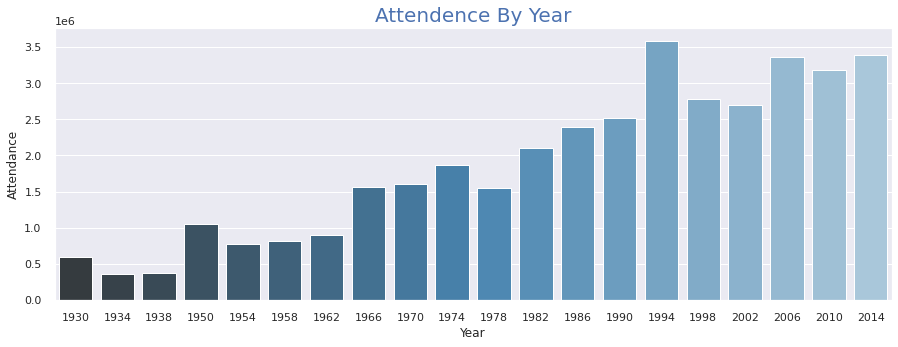

In [24]:
winnersChart = winnersDF
sns.set(rc={'figure.figsize':(15,5)})
plt.title("Attendence By Year",color="b",fontsize = 20)
AttendenceByYear = sns.barplot(x="Year", y="Attendance", data=winnersChart, palette="Blues_d")

### Attendence Per Match chart

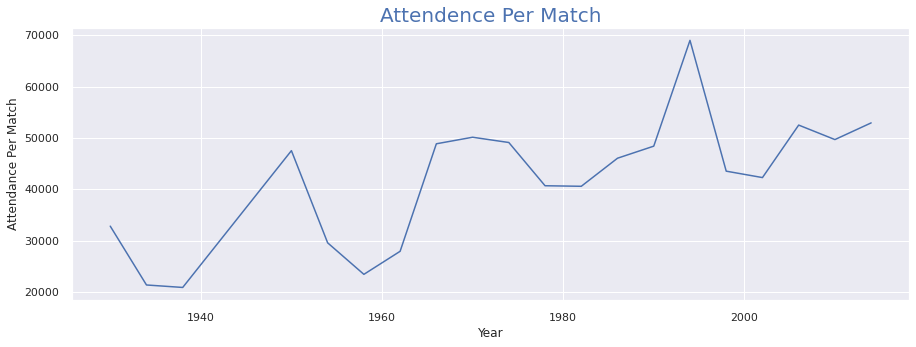

In [25]:
winnersChart["Attendance Per Match"] = winnersChart["Attendance"]/winnersChart["MatchesPlayed"]
plt.title("Attendence Per Match",color="b",fontsize = 20)
AttendencePermatch = sns.lineplot(x="Year", y="Attendance Per Match", data=winnersChart)

### Matches By Year chart

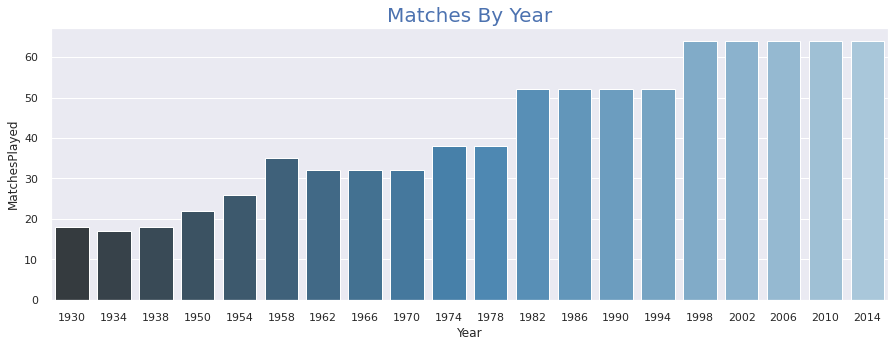

In [26]:
plt.title("Matches By Year",color="b",fontsize = 20)
AttendenceByYear = sns.barplot(x="Year", y="MatchesPlayed", data=winnersChart, palette="Blues_d")

### Team By Year chart

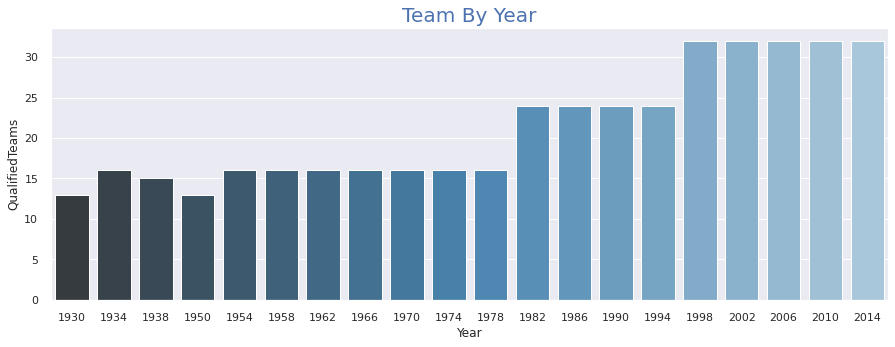

In [27]:
plt.title("Team By Year",color="b",fontsize = 20)
AttendenceByYear = sns.barplot(x="Year", y="QualifiedTeams", data=winnersChart, palette="Blues_d")

### Goals By Year chart

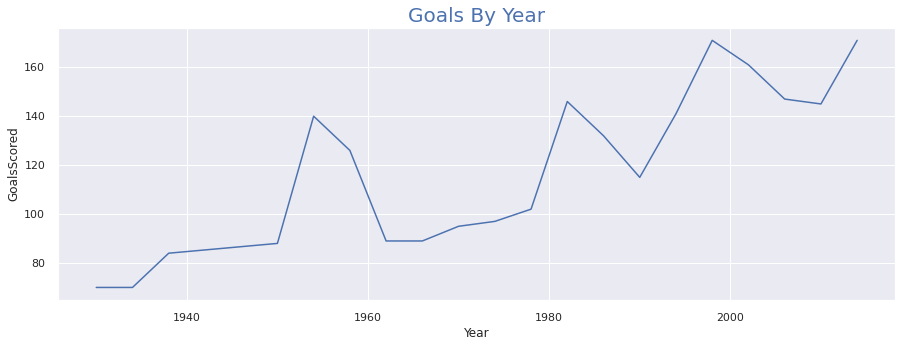

In [28]:
plt.title("Goals By Year",color="b",fontsize = 20)
AttendenceByYear = sns.lineplot(x="Year", y="GoalsScored", data=winnersChart)

### Goals Per Match chart

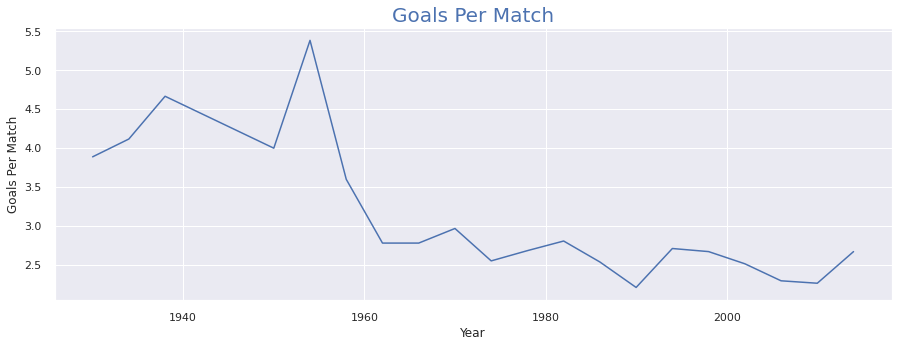

In [29]:
winnersChart["Goals Per Match"] = winnersChart["GoalsScored"]/winnersChart["MatchesPlayed"]
plt.title("Goals Per Match",color="b",fontsize = 20)
AttendencePermatch = sns.lineplot(x="Year", y="Goals Per Match", data=winnersChart)

### winnersAttendence

In [30]:
winnersAttendence = winnersDF[["Year","Country"]]

### matchesDFchart

In [31]:
matchesDFchart = matchesDF.groupby("Year")["Attendance"].max().reset_index()
matchesDFchart = pd.merge(matchesDFchart,matchesDF,on=["Year","Attendance"],how='left')
matchesDFchart = matchesDFchart[["Year","Attendance","Stage","Home Team Name","Away Team Name"]]
matchesDFchart = pd.merge(matchesDFchart,winnersAttendence,on=["Year"],how='left')
matchesDFchart["Is Home"] = matchesDFchart.apply(lambda matchesDFchart :is_home(matchesDFchart),axis = 1)

### Matches with highest number of attendance chart

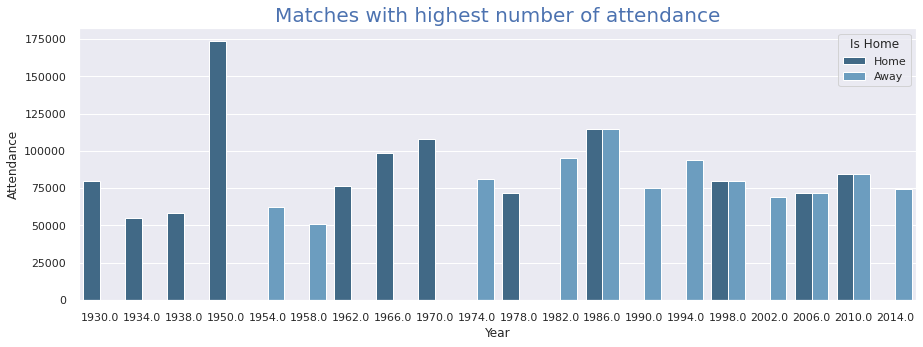

In [32]:
plt.title("Matches with highest number of attendance",color="b",fontsize = 20)
AttendenceByYear = sns.barplot(x="Year", y="Attendance", hue = "Is Home",data=matchesDFchart, palette="Blues_d")

### matchesDFchart2

In [33]:
matchesDFchart2 = matchesDF.sort_values(by="Attendance",ascending=False)[:10]
matchesDFchart2 = matchesDFchart2[["Year","Attendance"]]
matchesDFchart2 = matchesDFchart2.reset_index()
matchesDFchart2 = pd.merge(matchesDFchart2,matchesDF,on=["Year","Attendance"],how='left')
matchesDFchart2 = matchesDFchart2[["Year","Attendance","Stage","Home Team Name","Away Team Name"]]
matchesDFchart2 = pd.merge(matchesDFchart2,winnersAttendence,on=["Year"],how='left')
matchesDFchart2["Is Home"] = matchesDFchart2.apply(lambda matchesDFchart2 :is_home(matchesDFchart2),axis = 1)

### Matches with highest number of attendance chart

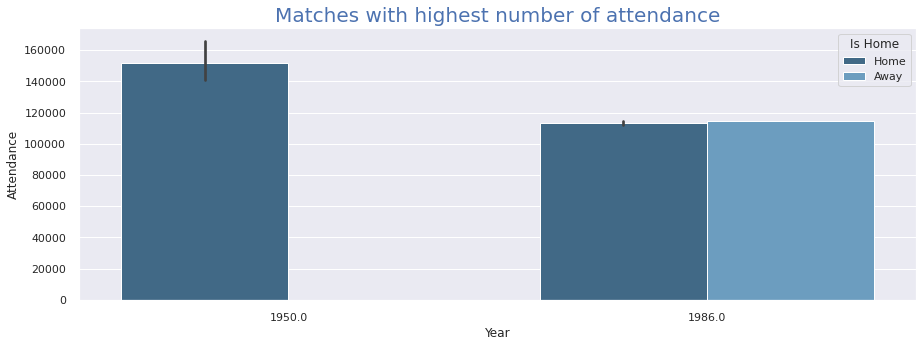

In [34]:
plt.title("Matches with highest number of attendance",color="b",fontsize = 20)
AttendenceByYear = sns.barplot(x="Year", y="Attendance", hue = "Is Home",data=matchesDFchart2, palette="Blues_d")

### Home Win chart

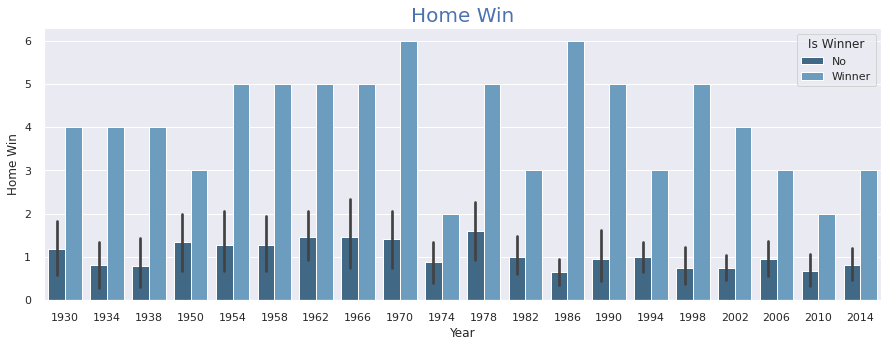

In [35]:
plt.title("Home Win",color="b",fontsize = 20)
AttendenceByYear = sns.barplot(x="Year", y="Home Win", hue = "Is Winner",data=totalInfor, palette="Blues_d")

### winnersDF is Home for chart

In [36]:
winnersDFisHome = winnersDF[["Year","Winner","Country"]]
winnersDFisHome = winnersDFisHome.rename(columns={"Winner": "Home Team Name"}, errors="raise")
winnersDFisHome["Away Team Name"] = ""
winnersDFisHome["Is Home"] = winnersDFisHome.apply(lambda winnersDFisHome:is_home(winnersDFisHome),axis = 1)

winnersDFisHome = winnersDFisHome.groupby("Is Home").count()
winnersDFisHome = winnersDFisHome.reset_index()
winnersDFisHome = winnersDFisHome.set_index('Is Home')

### winnersDFisHome chart

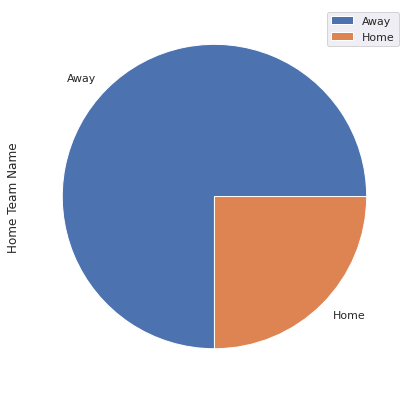

In [37]:
winnersDFisHome.plot.pie(y='Home Team Name', figsize=(7, 7))

## export csv

In [38]:
# totalInfor.to_csv("totalInfor.csv")
# winnersDF.to_csv("winnersDF.csv")
# playersDF.to_csv("playersDF.csv")
# matchesDF.to_csv("matchesDF.csv")
# winners.to_csv("winnersInfor.csv")